In [124]:
from torchvision import datasets, models, transforms,utils
import pandas as pd
from PIL import Image
import numpy as np
from torch.utils.data import Dataset, DataLoader
from pathlib import Path
import torch.nn as nn
import torch as torch
import matplotlib.pyplot as plt
import torchvision as torchvision
import time
from tqdm.notebook import tqdm
import torch.nn.functional as F
import requests
import numpy as np
import torchvision.transforms.functional as TF
from scipy.io import loadmat 
import random
import math

In [2]:
import requests

def download(url):
    proxies = {'http': 'llfs.ops.yahoo.com:4080', 'https': 'llfs.ops.yahoo.com:4080'}
    headers = {'Accept-Encoding': 'identity', 'user-agent': 'yahoo Slurp'}
    r = requests.get(url, headers=headers,proxies=proxies, verify=False, timeout=5)
    with open(url.split('/')[-1], 'wb+') as f:
        f.write(r.content)
        
download('https://download.pytorch.org/models/resnet34-333f7ec4.pth')        
download('https://download.pytorch.org/models/vgg16_bn-6c64b313.pth')
download('https://download.pytorch.org/models/resnet101-5d3b4d8f.pth')


! mkdir -p /home/yonatang/.cache/torch/hub/checkpoints/
! mv resnet34-333f7ec4.pth /home/yonatang/.cache/torch/hub/checkpoints/
! mv vgg16_bn-6c64b313.pth /home/yonatang/.cache/torch/hub/checkpoints/
! mv resnet101-5d3b4d8f.pth /home/yonatang/.cache/torch/hub/checkpoints/

/usr/local/lib/python3.6/site-packages/urllib3/connectionpool.py:1020: InsecureRequestWarning: Unverified HTTPS request is being made to host 'llfs.ops.yahoo.com'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#ssl-warnings
  InsecureRequestWarning,
/usr/local/lib/python3.6/site-packages/urllib3/connectionpool.py:1020: InsecureRequestWarning: Unverified HTTPS request is being made to host 'llfs.ops.yahoo.com'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#ssl-warnings
  InsecureRequestWarning,
/usr/local/lib/python3.6/site-packages/urllib3/connectionpool.py:1020: InsecureRequestWarning: Unverified HTTPS request is being made to host 'llfs.ops.yahoo.com'. Adding certificate verification is strongly advised. See: https://urllib3.readthedocs.io/en/latest/advanced-usage.html#ssl-warnings
  InsecureRequestWarning,


In [125]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [126]:
mean, std = [0.485, 0.456, 0.406], [0.229, 0.224, 0.225]

In [127]:
def mymshow(img, fig_size=[8,8],xlabel=None):
    img = img.permute(1,2,0).cpu()
    img = torch.clamp(img,0,1)
    fig,ax = plt.subplots()
    fig.set_size_inches(*fig_size)
    ax.imshow(img)
    ax.set_xlabel(xlabel,fontsize=16)
    plt.show()

In [128]:
class GreyDataset(Dataset):
    def __init__(self, path, img_size, mean, std, aug=False):
        self.transform = transforms.Compose([transforms.Resize(img_size),
                                             transforms.ToTensor(),                                    
                                            ])
        self.damaged_transforms = transforms.Compose([transforms.Resize(img_size),
                                            transforms.Grayscale(3),
                                            transforms.ToTensor(),                                           
                                            transforms.Normalize(mean,std),
                                           ])

        self.files = [i for i in Path(path).glob('**/*') if i.is_file()]
        self.aug = aug
        
    def __len__(self):
        return len(self.files)

    def __getitem__(self, idx):
        
        with open(self.files[idx], 'rb') as f:
            orig_image = Image.open(f).convert('RGB')

        image = self.transform(orig_image)
        gray = self.damaged_transforms(orig_image)

        if self.aug and random.random() > 0.5:
            image = TF.hflip(image)
            gray = TF.hflip(gray)

        
        return gray,image

In [85]:
def gen_datasets(img_size = (256,256)):
    train_path = '/home/yonatang/ephemeral_drive/train2014/'
    val_path = '/home/yonatang/ephemeral_drive/val2014/'
    train_dataset = GreyDataset(train_path, img_size, mean, std, True)
    val_dataset = GreyDataset(val_path, img_size, mean, std)
    return train_dataset,val_dataset

In [86]:
train_dataset,val_dataset = gen_datasets((256,256))

In [87]:
def denormalize(img, mean, std):
    # not accurate but its only for displaying images
    img = img.permute(1,2,0)
    img = img * torch.tensor(std) + torch.tensor(mean)
    img = img.permute(2,0,1)
    return img
    

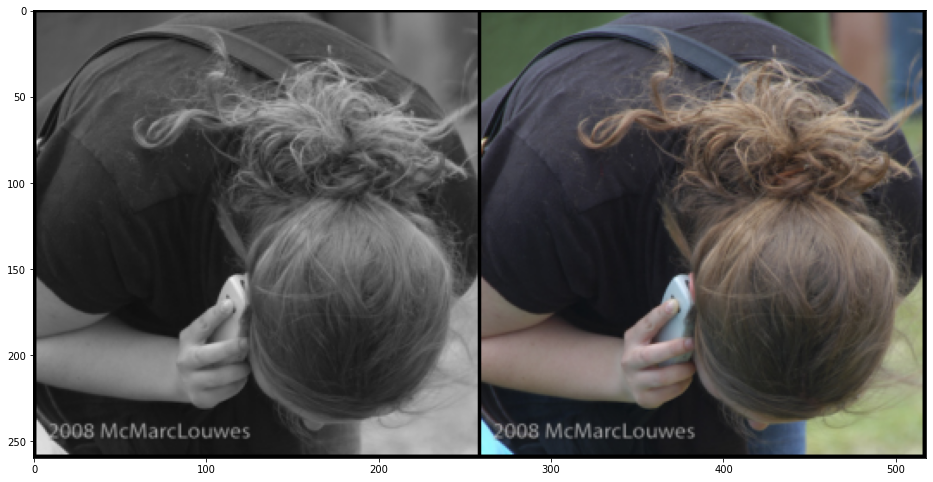

In [88]:
i=2
x,y = val_dataset[i]
#x = denormalize(x, mean, std)
mymshow(torchvision.utils.make_grid(torch.stack([x,y],dim=0),nrow=2),fig_size=(16,16)) 

In [62]:
def hook(module, input, output):
#    if type(module) != nn.Sequential:
    print(f'{module.__class__.__name__:<15} {str([*input[0].shape]):<20} --> {[*(output[1].shape if len(output)==2 else output.shape)]}')

def print_layers(module, input_shape):
    handles = []
    module.apply(lambda l: handles.append(l.register_forward_hook(hook)));
    module(torch.randn(*input_shape));
    [h.remove() for h in handles]

In [63]:
class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, padding=1):
        super(DoubleConv, self).__init__()
        self.layers = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=kernel_size, stride=1, padding=padding),                        
#            nn.BatchNorm2d(out_channels),
            nn.ReLU(),       

            nn.Conv2d(out_channels, out_channels, kernel_size=kernel_size, stride=1, padding=padding),
#            nn.BatchNorm2d(out_channels),
            nn.ReLU(),
#            nn.BatchNorm2d(out_channels),
        )
        
    def forward(self,x):
        return self.layers(x)

In [64]:
class Decoder(nn.Module):
    def __init__(self, up_in_channels, x_in_channels, kernel_size=3, padding=1, dropout=0):
        super(Decoder, self).__init__()
    
        self.upsample = nn.ConvTranspose2d(up_in_channels, up_in_channels//2, kernel_size=3, stride=2, padding=1, output_padding=1)
        
        in_channels = up_in_channels//2 + x_in_channels
        out_channels = in_channels//2
        
        self.layers = DoubleConv(in_channels, out_channels, kernel_size, padding)
        
    def forward(self, x, up):
        up = self.upsample(up)
        return self.layers(torch.cat([x,up],dim=1)) 

In [65]:
class ResnetUnet(nn.Module):
    def __init__(self, resnet):
        super(ResnetUnet, self).__init__()
        
        self.encoder0 = nn.Sequential(resnet.conv1, resnet.bn1, resnet.relu)
        self.maxpool = resnet.maxpool
        
        self.encoder1 = resnet.layer1
        self.encoder2 = resnet.layer2
        self.encoder3 = resnet.layer3
        self.encoder4 = resnet.layer4
    
    
        channel_factor = 4
    
        self.middle = DoubleConv(512*channel_factor,512*channel_factor)   
    
        self.decoder0 = Decoder(512*channel_factor,256*channel_factor)
        self.decoder1 = Decoder(256*channel_factor,128*channel_factor)
        self.decoder2 = Decoder(128*channel_factor,64*channel_factor)
        self.decoder3 = Decoder(64*channel_factor,64)
        
        channels = (64*channel_factor//2+64)//2
        
        self.resize = nn.ConvTranspose2d(channels, 16, kernel_size=3, stride=2, padding=1, output_padding=1)
        
        self.final_layer = nn.Sequential(nn.Conv2d(16, 3, kernel_size=3, stride=1, padding=1))
        
        self.final = nn.Sequential()
    def forward(self, x):
        a1 = self.encoder0(x)        
        a1_pooled = self.maxpool(a1)
        a2 = self.encoder1(a1_pooled)           
        a3 = self.encoder2(a2)
        a4 = self.encoder3(a3)
        a5 = self.encoder4(a4)
        mid = self.middle(a5)

        d1 = self.decoder0(a4,mid)
        d2 = self.decoder1(a3,d1)
        d3 = self.decoder2(a2,d2)
        d4 = self.decoder3(a1,d3)

        resized = self.resize(d4)       
        final = self.final_layer(resized)

        return final
        
        

In [66]:
class AverageMeter(object):
    def __init__(self):
        self.avg = 0
        self.sum = 0
        self.count = 0 

    def update(self, val, n=1):
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count

In [67]:
def single_epoch(dataloader, model, loss_function, optimizer=None,scheduler=None):
    
    losses = AverageMeter()

    for x,y in tqdm(dataloader,leave=False):
        y_hat = model(x.to(device))
        y = y.to(device)
        loss = loss_function(y_hat, y)
            
        if model.training:
            loss.backward()
            optimizer.step()
            optimizer.zero_grad()
#            if scheduler is not None: scheduler.step()

        batch_size = len(y)
        losses.update(loss.item(), batch_size)
    return losses.avg

def fit(epochs, model, train_dl, valid_dl, loss_func, optimizer, scheduler=None):
    
    
    min_loss = 10
    for epoch in range(epochs):
        start_time = time.time()
        
        lr = optimizer.param_groups[0]['lr'] 
        model.train()
        train_loss = single_epoch(train_dl, model, loss_func, optimizer, scheduler)
        

            
        model.eval()
        with torch.no_grad():
            valid_loss = single_epoch(valid_dl, model, loss_func)
            
        if valid_loss < min_loss:
            min_loss = valid_loss
            torch.save(model, 'colornet.pt')
        
        scheduler.step(valid_loss)
        
        secs = int(time.time() - start_time)
        print(f'Epoch {epoch} {secs}[sec] lr={lr:.6f}',end=' ')
        print(f'Train: loss {train_loss:.4f}. ',end='\t')
        print(f'Valid: loss {valid_loss:.4f}.')

In [68]:
class Hook():
    def __init__(self, module):
        self.stored = None
        self.handle = module.register_forward_hook(self.hook_fn)
    def hook_fn(self, module, input, output):
        self.stored = output
    def remove(self):
        self.handle.remove()
        
        
        
class FeatureLoss(nn.Module):
    def __init__(self, layer_wgts=[20,70,10]):
        super().__init__()
        self.base_loss = F.l1_loss    

        self.m_feat = torchvision.models.vgg16_bn(True).to(device).features.eval()
        self.m_feat = self.m_feat.requires_grad_(False)

        blocks = [i-1 for i,o in enumerate(self.m_feat.children()) if isinstance(o,nn.MaxPool2d)]
        loss_features = [self.m_feat[i] for i in blocks[2:5]]

        self.hooks = [Hook(module) for module in loss_features]
        self.wgts = layer_wgts

    def make_features(self, x, clone=False):
        self.m_feat(x)
        return [(o.stored.clone() if clone else o.stored) for o in self.hooks]
    
    def forward(self, input, target):
        out_feat = self.make_features(target, clone=True)
        in_feat = self.make_features(input)
        self.feat_losses = [self.base_loss(input,target)]
        self.feat_losses += [self.base_loss(f_in, f_out)*w
                             for f_in, f_out, w in zip(in_feat, out_feat, self.wgts)]

        return sum(self.feat_losses)
    def __del__(self): [hook.remove() for hook in self.hooks]  

In [69]:
def gen_net_opt(lr,wd=0):
    resnet=torchvision.models.resnet101(pretrained=True)
    model = ResnetUnet(resnet).to(device)
    optimizer = torch.optim.Adam(model.parameters(),lr=lr,weight_decay=wd)
    return model, optimizer

In [70]:
def get_dataloader(img_size=(256,256),bs=8):
    train_dataset,val_dataset = gen_datasets(img_size)
    train_dl = DataLoader(
        train_dataset,
        batch_size=bs,
        num_workers=4,
        pin_memory=True,
        shuffle=True)

    val_dl = DataLoader(
        val_dataset,
        batch_size=bs,
        num_workers=4,
        pin_memory=True,
        shuffle=False) 
    return train_dl,val_dl

In [ ]:
bs = 16
train_dl,val_dl=get_dataloader((256,256),bs=bs)
model,optimizer = gen_net_opt(0.00001, 0) 
epochs=50
#total_steps=epochs*len(train_dl)
#scheduler = None#torch.optim.lr_scheduler.OneCycleLR(optimizer,0.00003,total_steps=total_steps)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=2)
fit(epochs,model,train_dl,val_dl,FeatureLoss([20,70,10]),optimizer,scheduler)

  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 0 2559[sec] lr=0.000010 Train: loss 2.4488. 	Valid: loss 1.5290.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 1 2563[sec] lr=0.000010 Train: loss 1.1924. 	Valid: loss 1.0475.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 2 2562[sec] lr=0.000010 Train: loss 1.0262. 	Valid: loss 0.9887.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 3 2564[sec] lr=0.000010 Train: loss 0.9802. 	Valid: loss 0.9575.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 4 2561[sec] lr=0.000010 Train: loss 0.9475. 	Valid: loss 0.9352.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 5 2564[sec] lr=0.000010 Train: loss 0.9234. 	Valid: loss 0.9228.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 6 2562[sec] lr=0.000010 Train: loss 0.9037. 	Valid: loss 0.9097.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 7 2560[sec] lr=0.000010 Train: loss 0.8857. 	Valid: loss 0.9033.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 8 2560[sec] lr=0.000010 Train: loss 0.8709. 	Valid: loss 0.8970.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



  0%|          | 0/2532 [00:00<?, ?it/s]

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

IOPub message rate exceed

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 14 2560[sec] lr=0.000010 Train: loss 0.8100. 	Valid: loss 0.8797.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 15 2558[sec] lr=0.000010 Train: loss 0.8020. 	Valid: loss 0.8817.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 16 2565[sec] lr=0.000010 Train: loss 0.7946. 	Valid: loss 0.8781.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 17 2559[sec] lr=0.000010 Train: loss 0.7871. 	Valid: loss 0.8792.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 18 2557[sec] lr=0.000010 Train: loss 0.7801. 	Valid: loss 0.8787.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 19 2556[sec] lr=0.000010 Train: loss 0.7736. 	Valid: loss 0.8798.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 20 2559[sec] lr=0.000001 Train: loss 0.7564. 	Valid: loss 0.8746.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 21 2559[sec] lr=0.000001 Train: loss 0.7521. 	Valid: loss 0.8746.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 22 2556[sec] lr=0.000001 Train: loss 0.7492. 	Valid: loss 0.8755.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 23 2556[sec] lr=0.000001 Train: loss 0.7469. 	Valid: loss 0.8766.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 24 2558[sec] lr=0.000000 Train: loss 0.7441. 	Valid: loss 0.8749.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 25 2560[sec] lr=0.000000 Train: loss 0.7438. 	Valid: loss 0.8756.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 26 2555[sec] lr=0.000000 Train: loss 0.7435. 	Valid: loss 0.8758.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 27 2557[sec] lr=0.000000 Train: loss 0.7431. 	Valid: loss 0.8763.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 28 2557[sec] lr=0.000000 Train: loss 0.7432. 	Valid: loss 0.8769.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 29 2555[sec] lr=0.000000 Train: loss 0.7431. 	Valid: loss 0.8763.


  0%|          | 0/5174 [00:00<?, ?it/s]

  0%|          | 0/2532 [00:00<?, ?it/s]

Epoch 30 2558[sec] lr=0.000000 Train: loss 0.7431. 	Valid: loss 0.8757.


  0%|          | 0/5174 [00:00<?, ?it/s]

In [119]:
model = torch.load('colornet.pt')

In [79]:
model

ResnetUnet(
  (encoder0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
  )
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (encoder1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256

In [23]:
torch.save(model, 'colornet_9054.pt')

In [121]:
def print_images(model, dataset, i):
    x,y = dataset[i]
    model = model.to(device)
    model.eval()
    with torch.no_grad():
        yhat =  model(x.unsqueeze(0).to(device)).squeeze(0).cpu().detach()
    x = denormalize(x, mean, std)
    mymshow(torchvision.utils.make_grid(torch.stack([x,y,yhat],dim=0),nrow=3),fig_size=(16,16)) 

14561


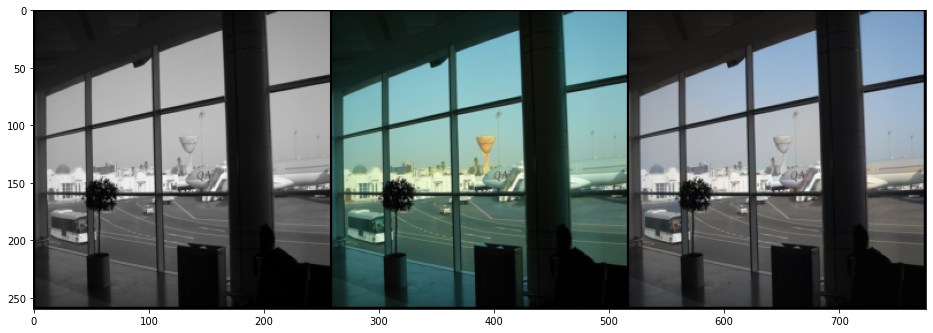

4274


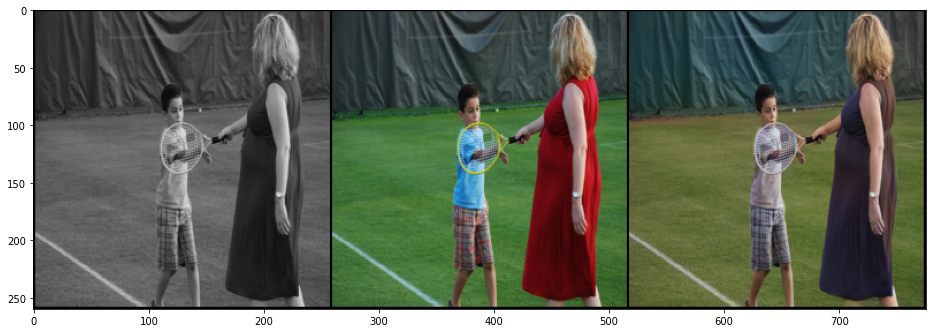

28139


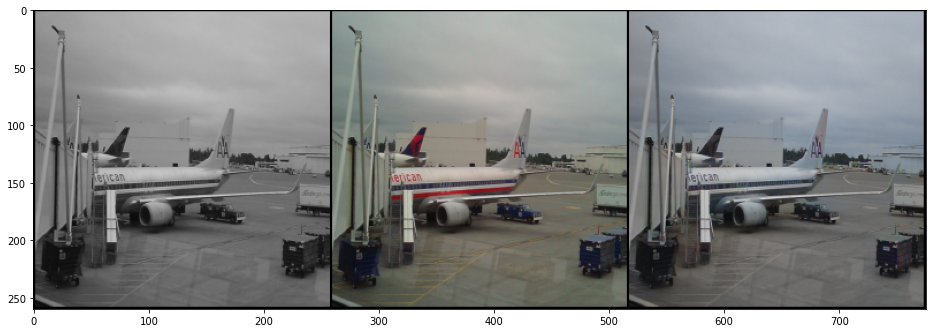

32714


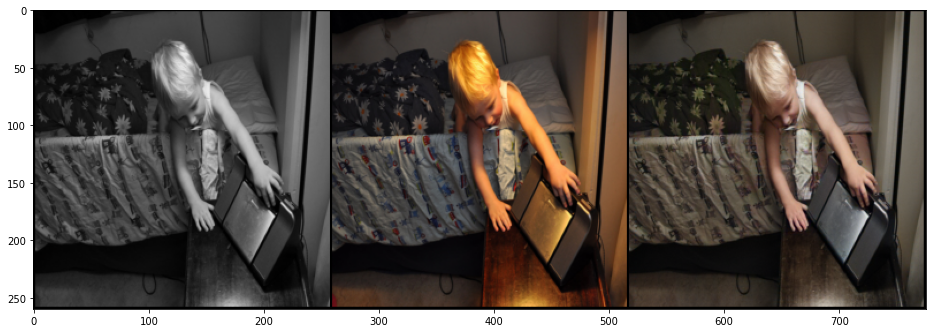

23075


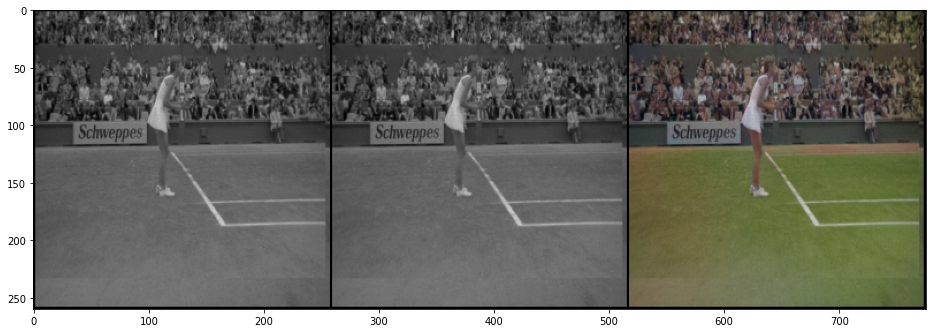

40256


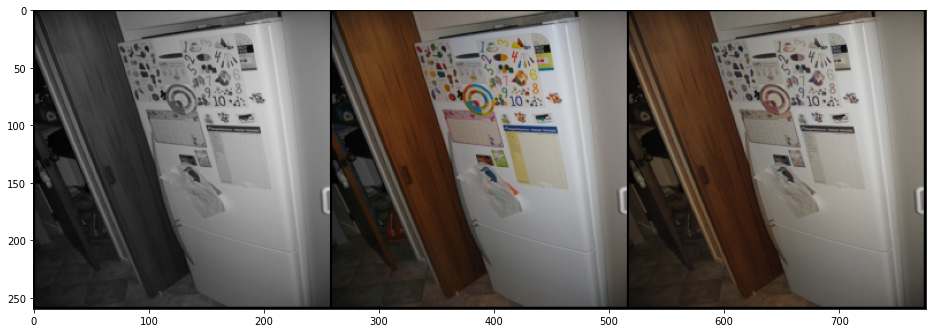

5956


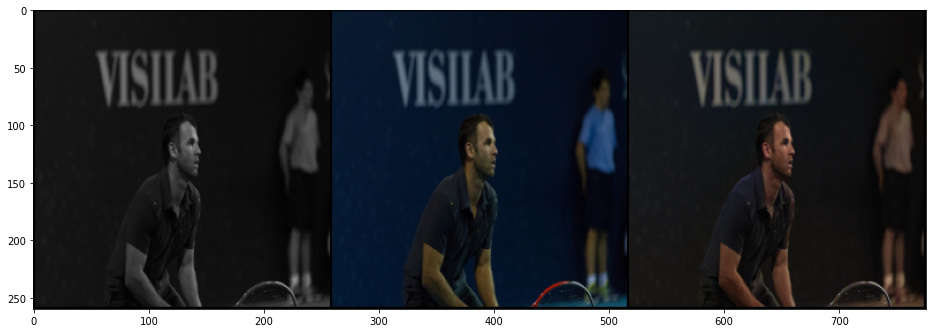

346


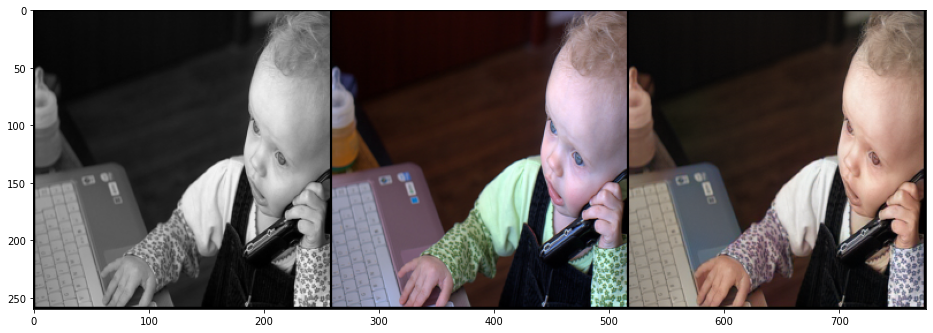

6977


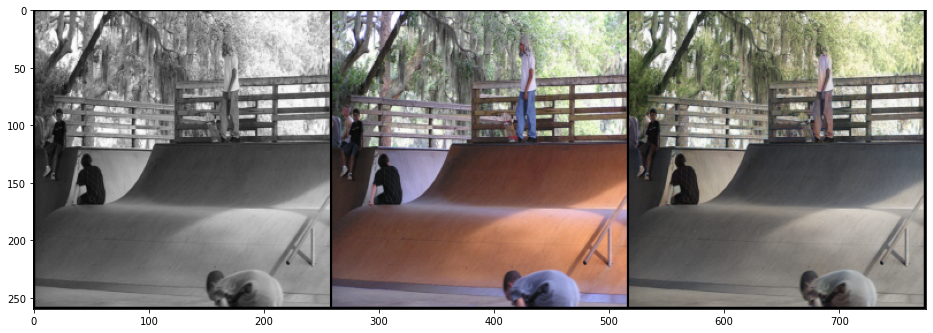

36242


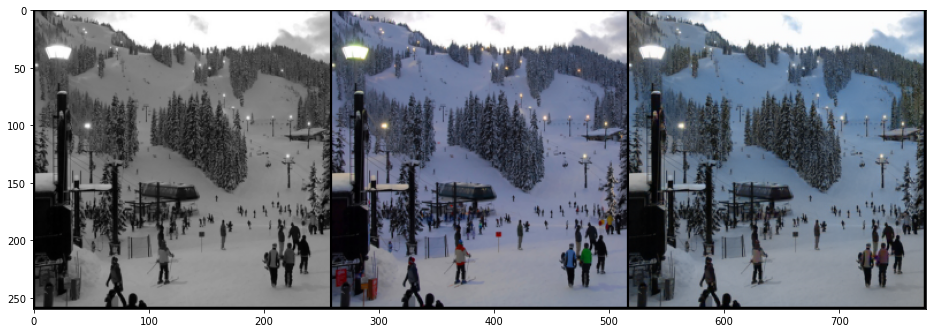

32746


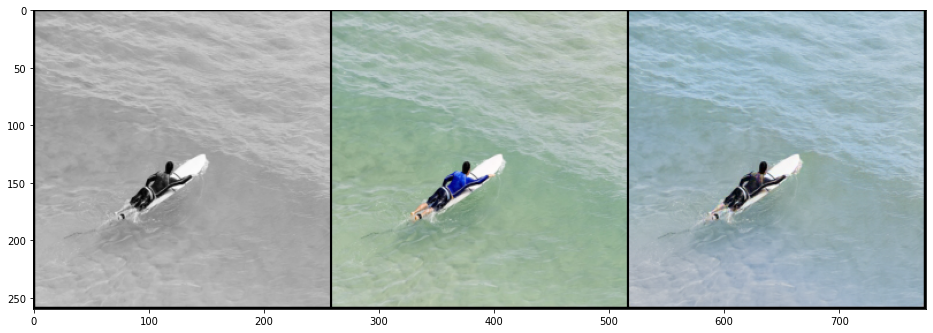

260


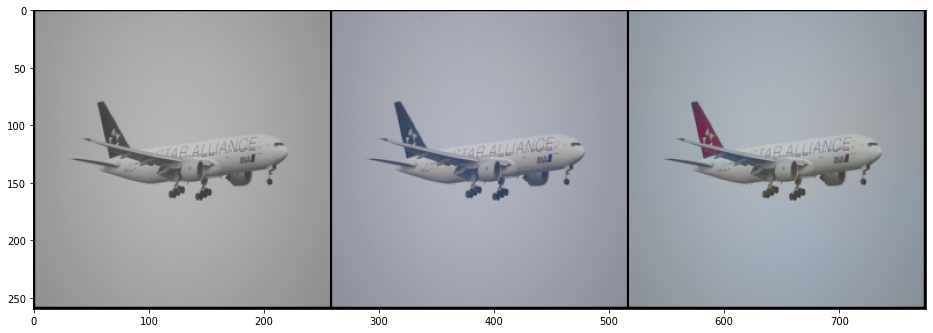

5264


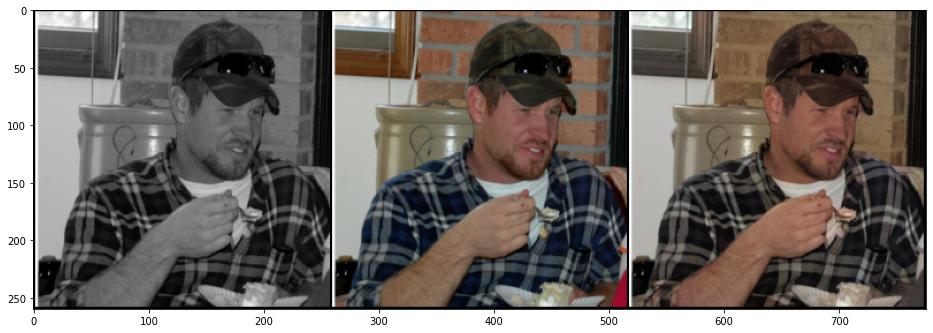

21898


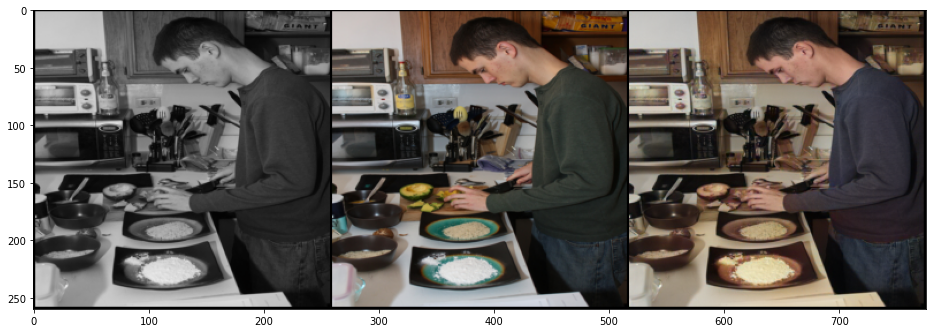

11649


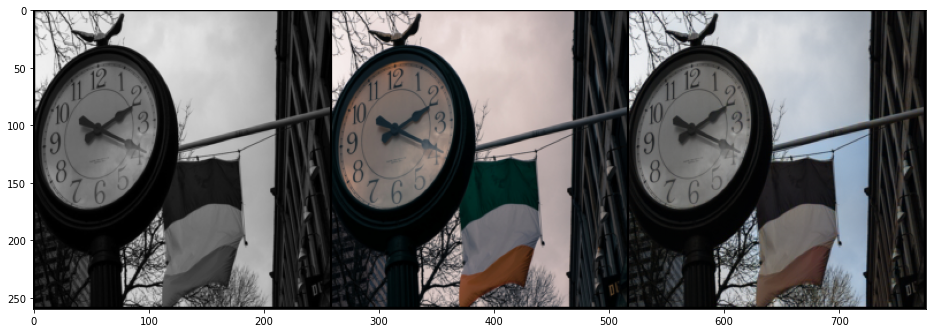

11541


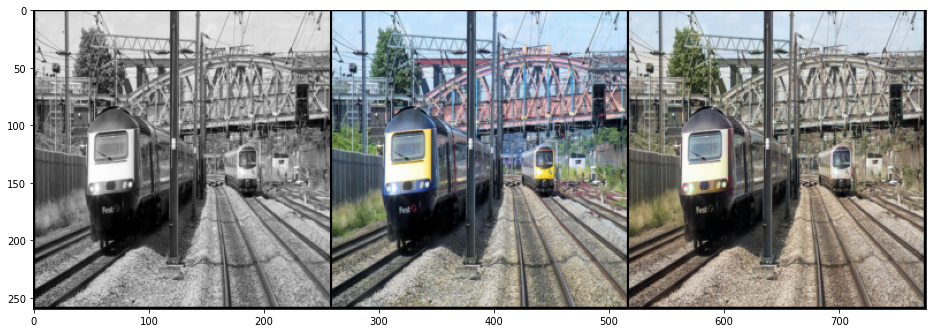

5828


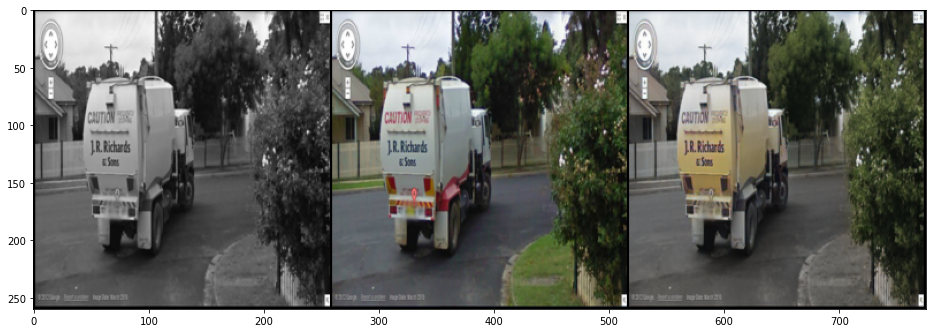

11432


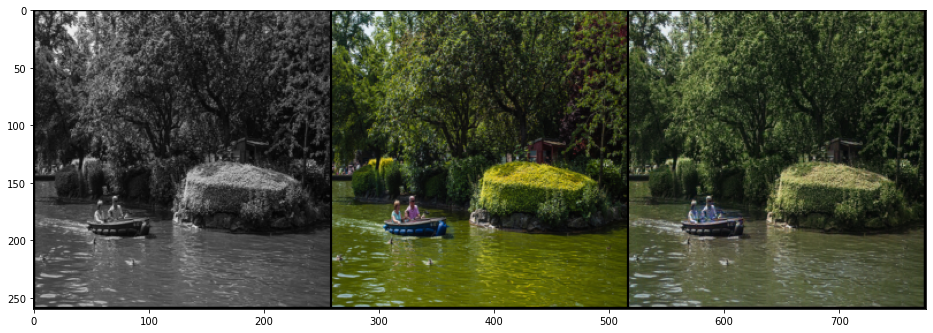

30197


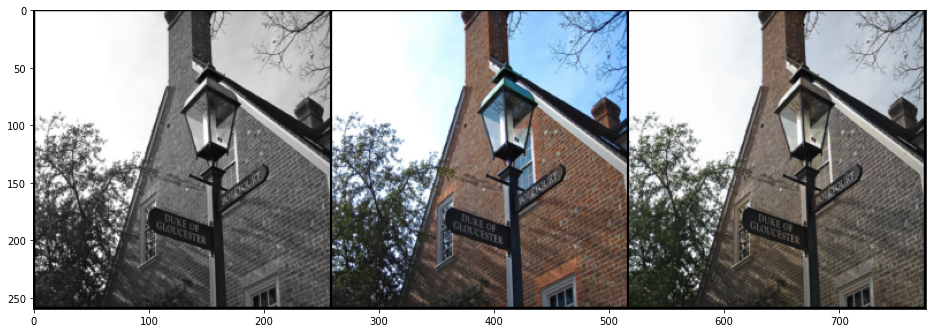

40113


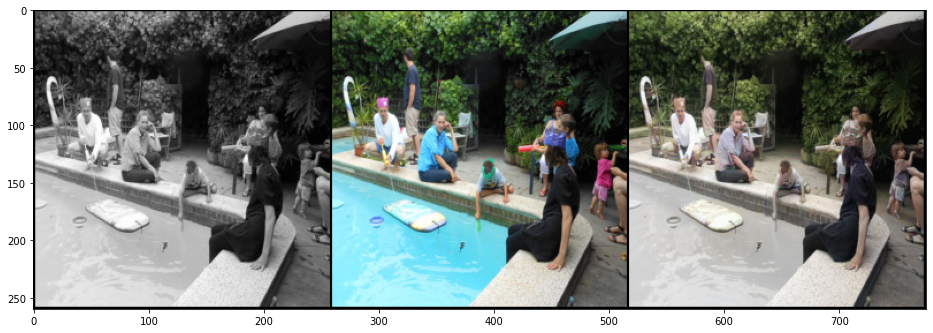

11402


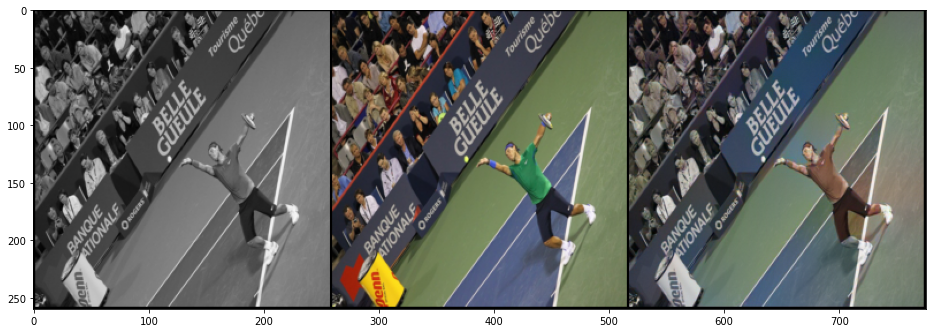

8759


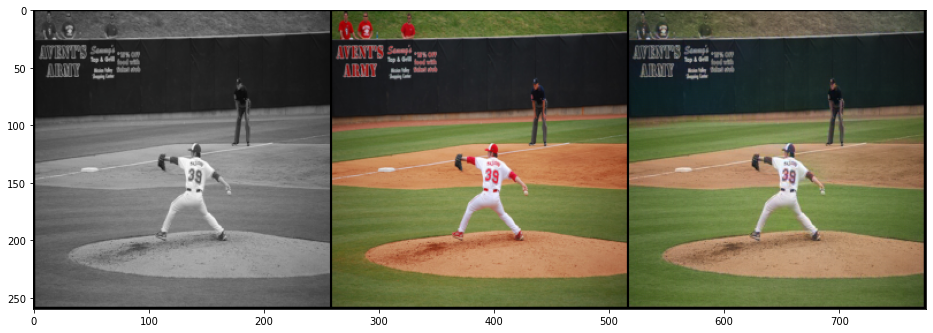

7341


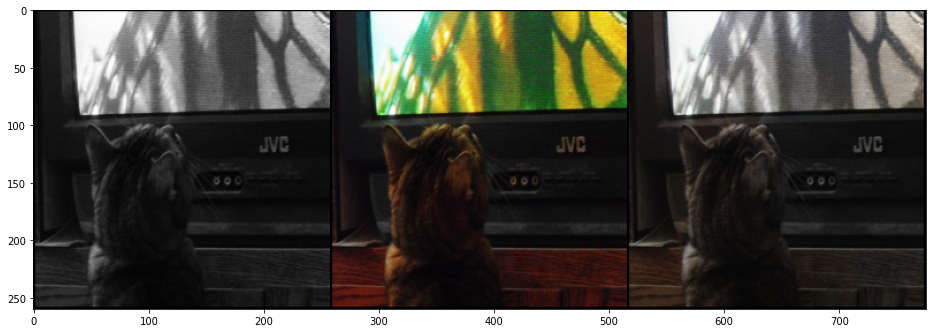

3188


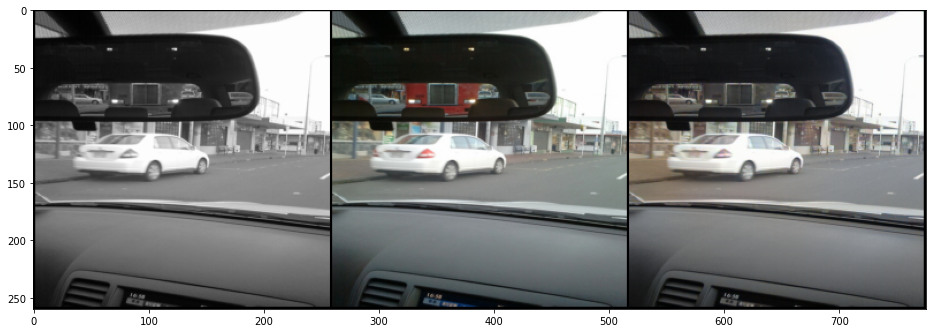

24613


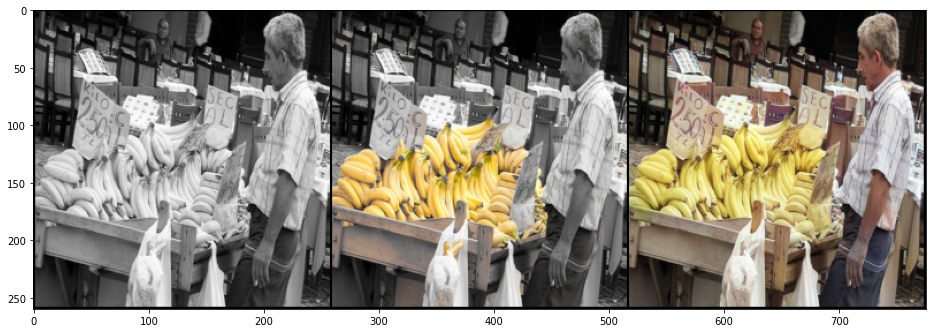

484


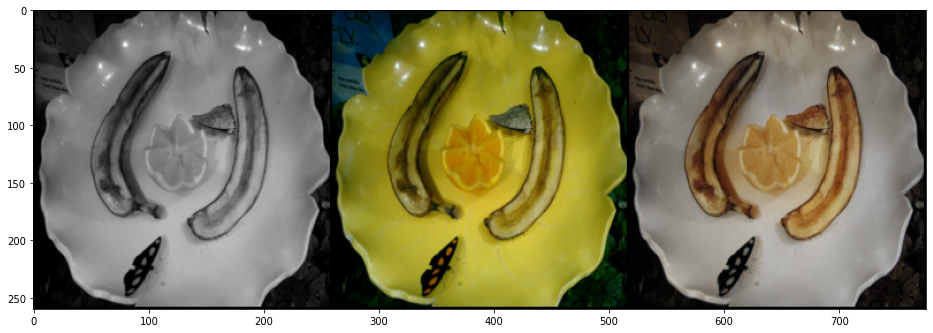

34108


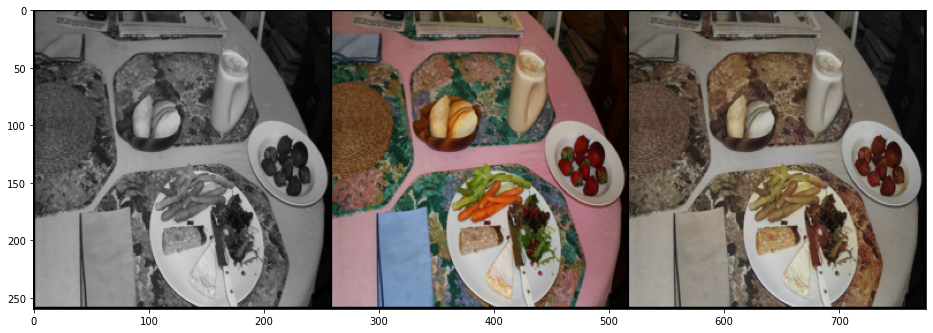

14463


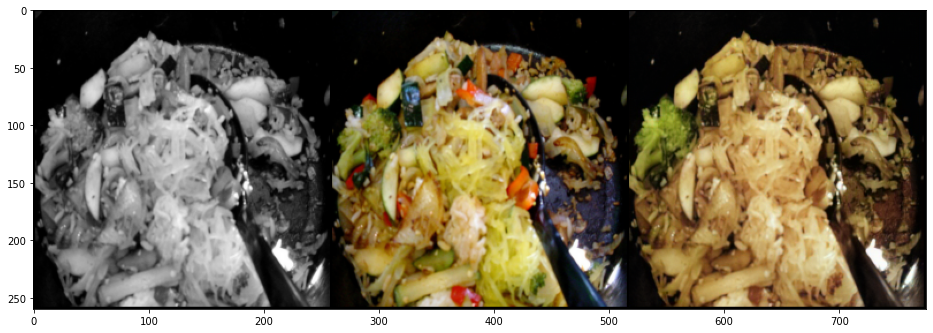

14442


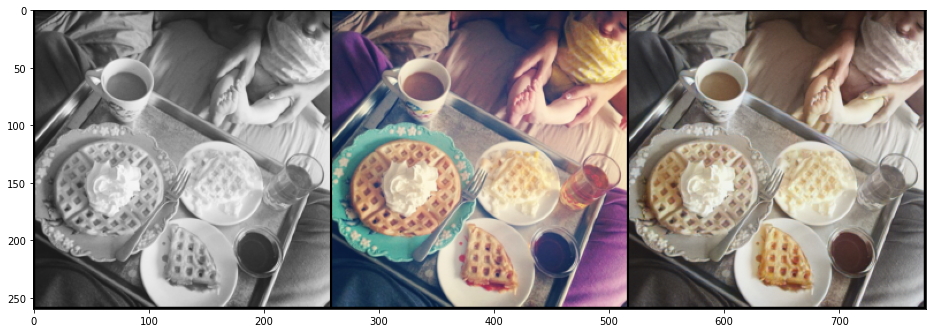

10080


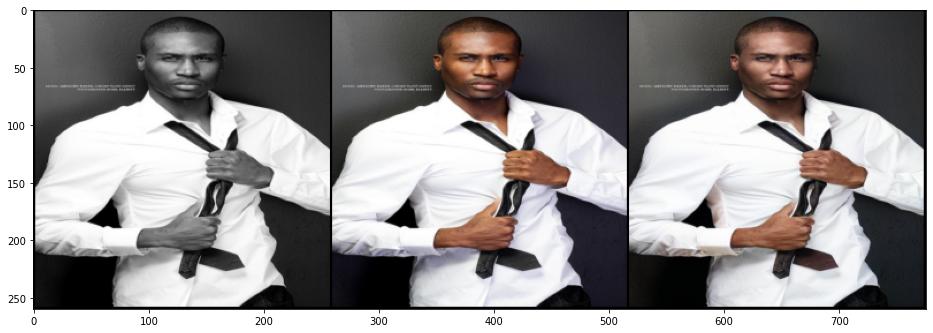

25092


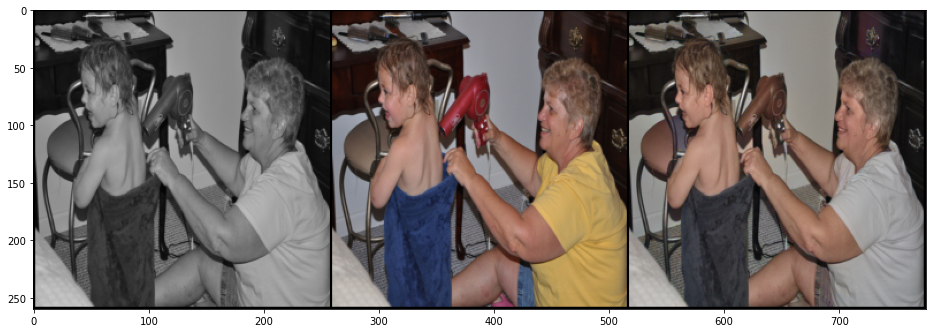

14551


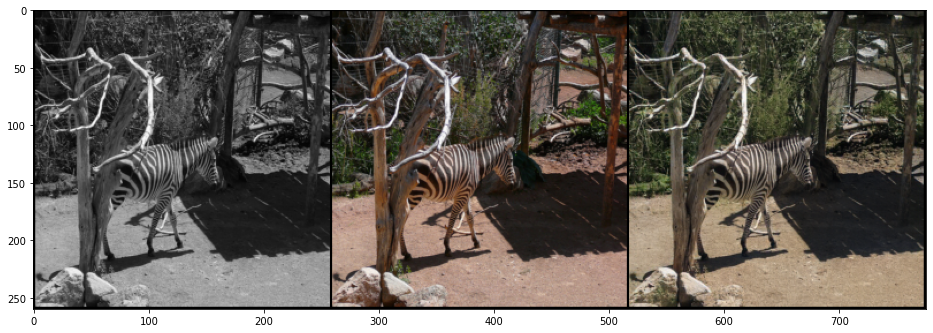

8280


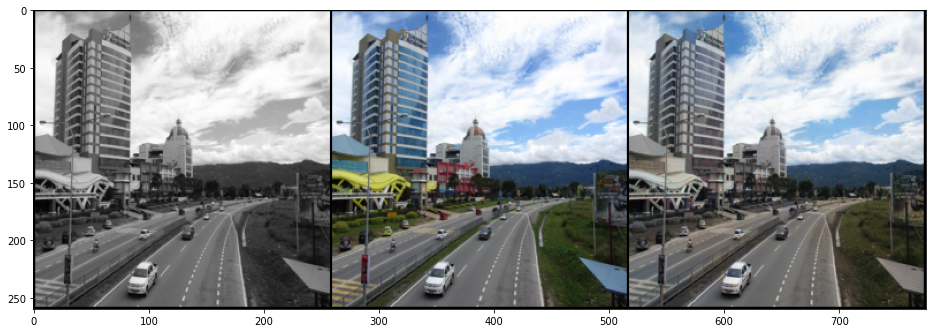

6150


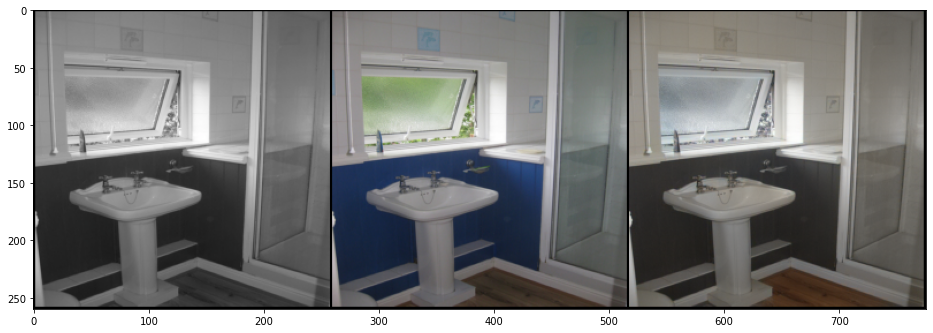

20348


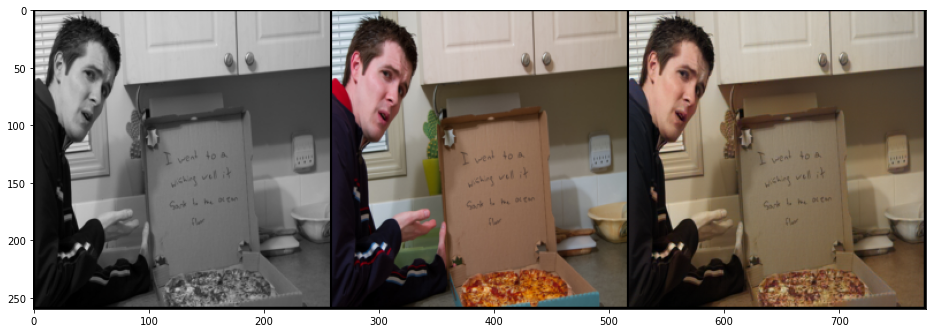

26119


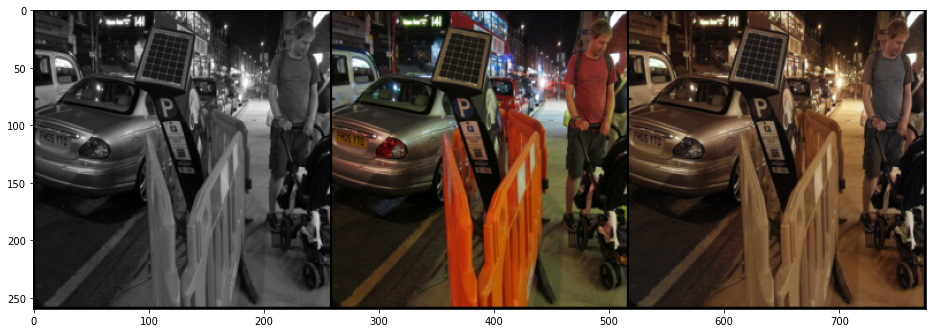

36394


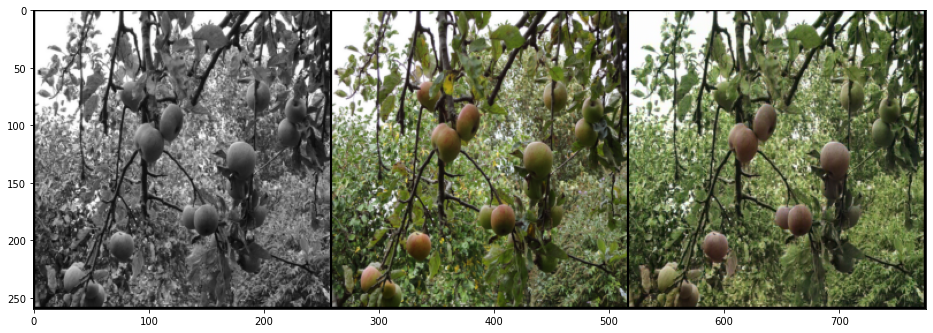

19130


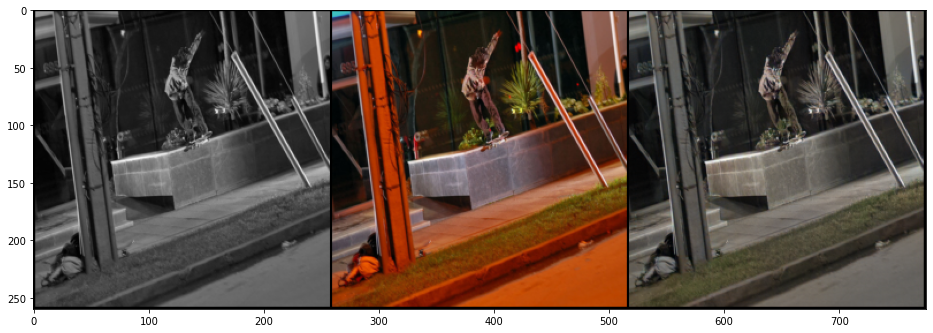

21076


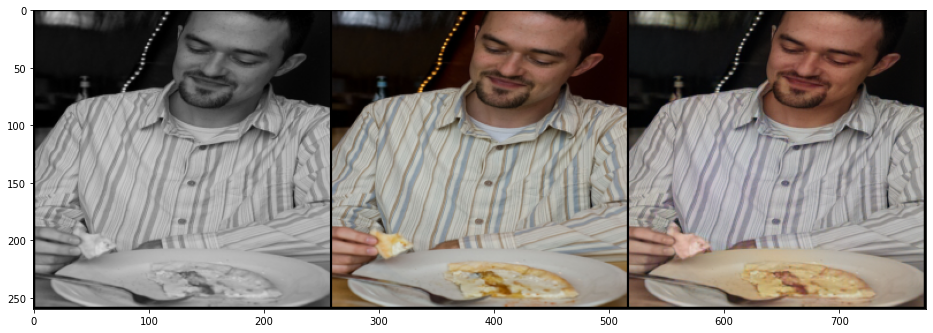

19699


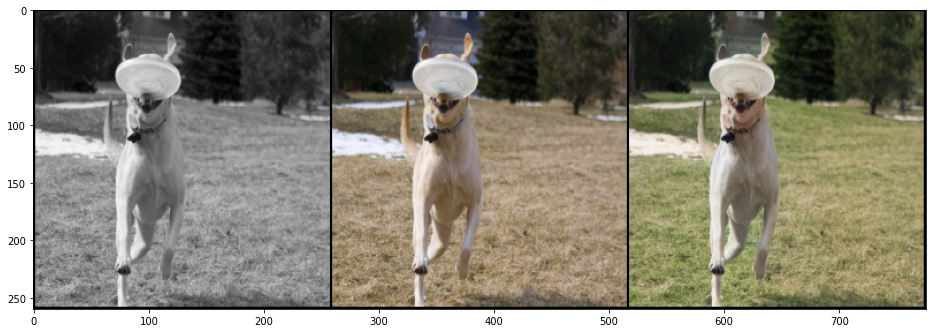

11181


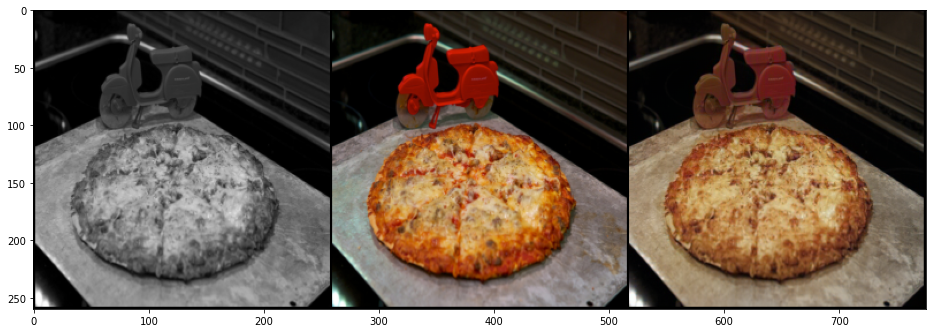

27658


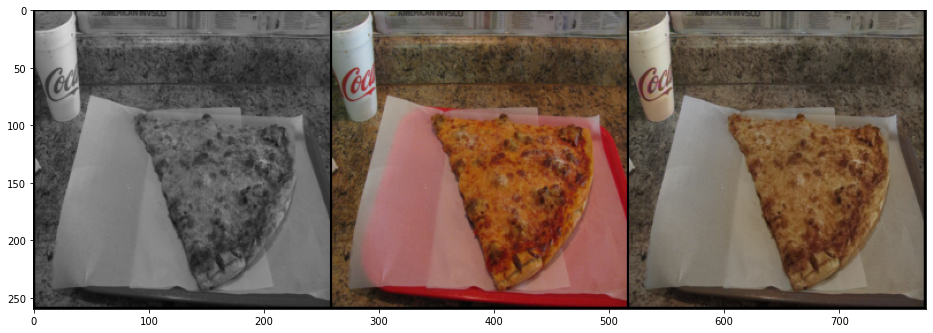

4742


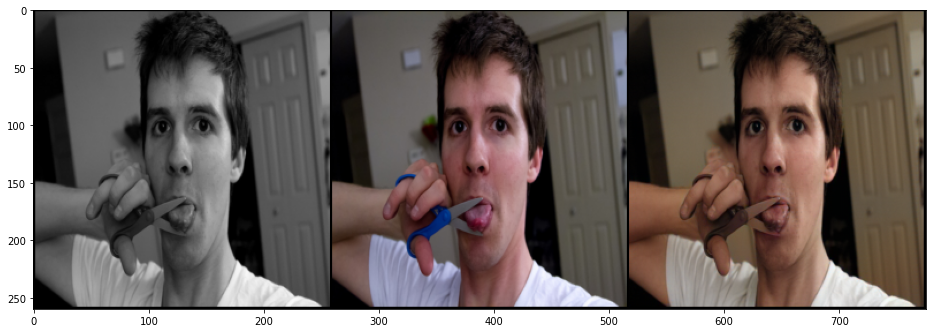

24026


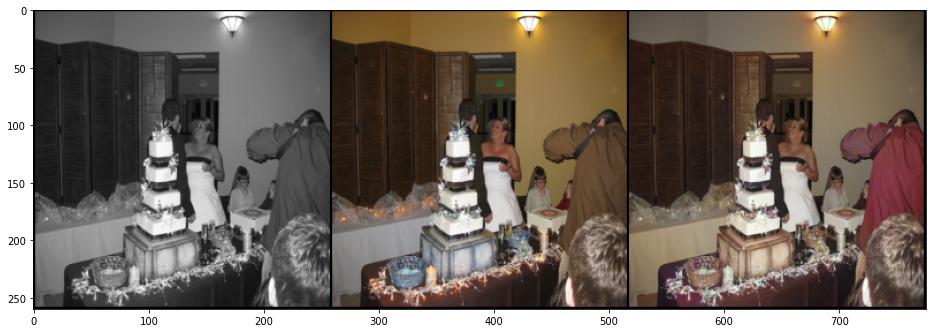

750


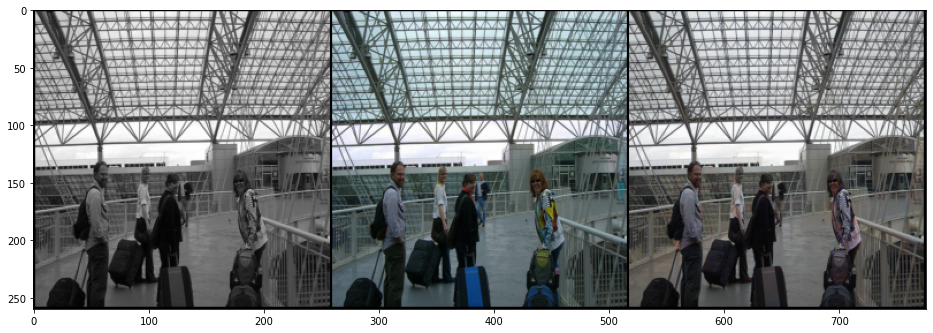

38316


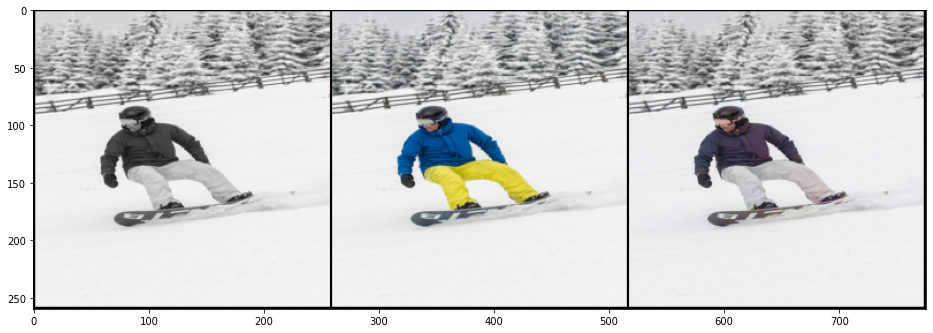

2435


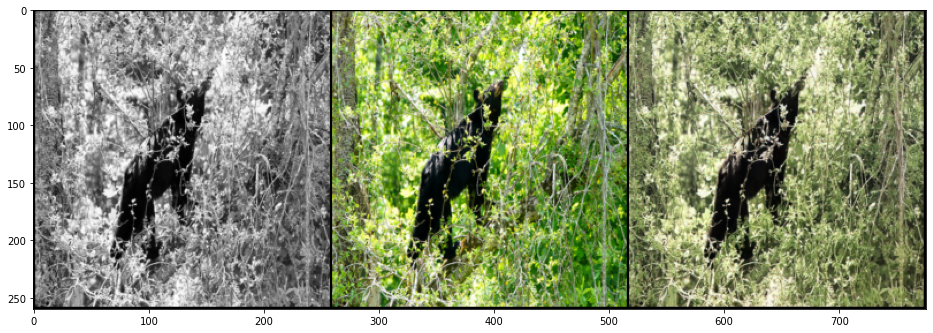

18055


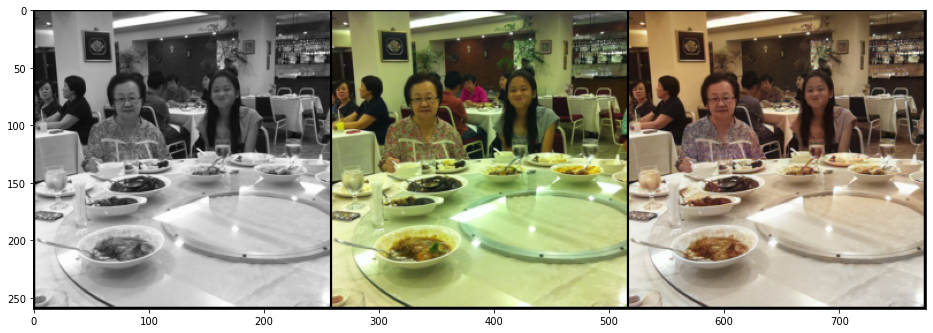

16860


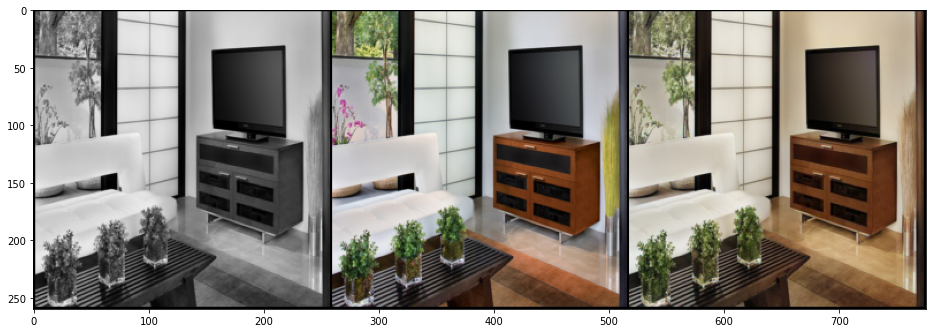

2756


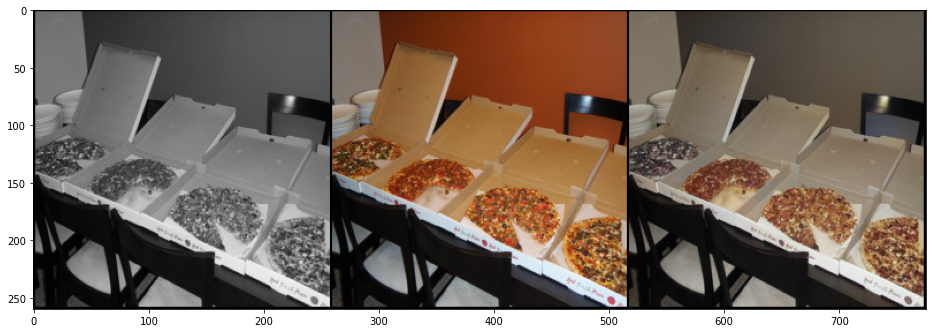

In [129]:
train_dataset,val_dataset = gen_datasets((256,256))
for i in range(50):
    idx = random.randint(0,len(val_dataset))
    print(idx)
    print_images(model,val_dataset,idx)

50000

In [30]:
model,optimizer = gen_net_opt(0.0001, 0) 
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=3)
fit(30,model,train_dl,val_dl,nn.MSELoss(),optimizer,scheduler)

  0%|          | 0/438 [00:00<?, ?it/s]

  0%|          | 0/69 [00:00<?, ?it/s]

Epoch 0 44[sec] lr=0.0001 Train: loss 0.0686. 	Valid: loss 0.0094.


  0%|          | 0/438 [00:00<?, ?it/s]

  0%|          | 0/69 [00:00<?, ?it/s]

Epoch 1 44[sec] lr=0.0001 Train: loss 0.0096. 	Valid: loss 0.0081.


  0%|          | 0/438 [00:00<?, ?it/s]

  0%|          | 0/69 [00:00<?, ?it/s]

Epoch 2 44[sec] lr=0.0001 Train: loss 0.0082. 	Valid: loss 0.0074.


  0%|          | 0/438 [00:00<?, ?it/s]

  0%|          | 0/69 [00:00<?, ?it/s]

Epoch 3 44[sec] lr=0.0001 Train: loss 0.0075. 	Valid: loss 0.0073.


  0%|          | 0/438 [00:00<?, ?it/s]

  0%|          | 0/69 [00:00<?, ?it/s]

Epoch 4 44[sec] lr=0.0001 Train: loss 0.0071. 	Valid: loss 0.0071.


  0%|          | 0/438 [00:00<?, ?it/s]

  0%|          | 0/69 [00:00<?, ?it/s]

Epoch 5 44[sec] lr=0.0001 Train: loss 0.0084. 	Valid: loss 0.0083.


  0%|          | 0/438 [00:00<?, ?it/s]

  0%|          | 0/69 [00:00<?, ?it/s]

Epoch 6 44[sec] lr=0.0001 Train: loss 0.0076. 	Valid: loss 0.0072.


  0%|          | 0/438 [00:00<?, ?it/s]

  0%|          | 0/69 [00:00<?, ?it/s]

Epoch 7 44[sec] lr=0.0001 Train: loss 0.0063. 	Valid: loss 0.0071.


  0%|          | 0/438 [00:00<?, ?it/s]

  0%|          | 0/69 [00:00<?, ?it/s]

Epoch 8 44[sec] lr=0.0001 Train: loss 0.0063. 	Valid: loss 0.0071.


  0%|          | 0/438 [00:00<?, ?it/s]

  0%|          | 0/69 [00:00<?, ?it/s]

Epoch 9 44[sec] lr=0.0001 Train: loss 0.0057. 	Valid: loss 0.0068.


  0%|          | 0/438 [00:00<?, ?it/s]

  0%|          | 0/69 [00:00<?, ?it/s]

Epoch 10 44[sec] lr=0.0001 Train: loss 0.0053. 	Valid: loss 0.0074.


  0%|          | 0/438 [00:00<?, ?it/s]

  0%|          | 0/69 [00:00<?, ?it/s]

Epoch 11 44[sec] lr=0.0001 Train: loss 0.0051. 	Valid: loss 0.0070.


  0%|          | 0/438 [00:00<?, ?it/s]

  0%|          | 0/69 [00:00<?, ?it/s]

Epoch 12 44[sec] lr=0.0001 Train: loss 0.0048. 	Valid: loss 0.0070.


  0%|          | 0/438 [00:00<?, ?it/s]

  0%|          | 0/69 [00:00<?, ?it/s]

Epoch 13 44[sec] lr=0.0001 Train: loss 0.0046. 	Valid: loss 0.0069.


  0%|          | 0/438 [00:00<?, ?it/s]

  0%|          | 0/69 [00:00<?, ?it/s]

Epoch 14 44[sec] lr=1e-05 Train: loss 0.0041. 	Valid: loss 0.0065.


  0%|          | 0/438 [00:00<?, ?it/s]

  0%|          | 0/69 [00:00<?, ?it/s]

Epoch 15 44[sec] lr=1e-05 Train: loss 0.0039. 	Valid: loss 0.0065.


  0%|          | 0/438 [00:00<?, ?it/s]

  0%|          | 0/69 [00:00<?, ?it/s]

Epoch 16 44[sec] lr=1e-05 Train: loss 0.0039. 	Valid: loss 0.0066.


  0%|          | 0/438 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [49]:
def print_images(model, dataset, i):
    x,y = dataset[i]
    model = model.to(device)
    model.eval()
    with torch.no_grad():
        yhat =  model(x.unsqueeze(0).to(device)).squeeze(0).cpu().detach()
    x = denormalize(x, mean, std)
    mymshow(torchvision.utils.make_grid(torch.stack([x,y,yhat],dim=0),nrow=3),fig_size=(16,16)) 

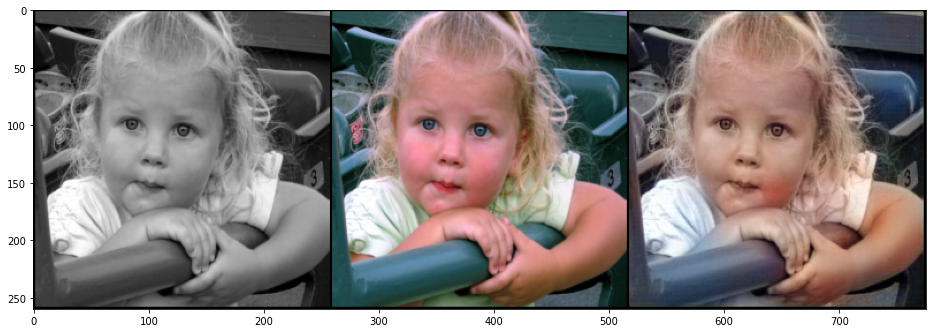

In [31]:
x,y = train_dataset[9]
model = model.to(device)
model.eval()
with torch.no_grad():
    yhat =  model(x.unsqueeze(0).to(device)).squeeze(0).cpu().detach()
x = denormalize(x, mean, std)
mymshow(torchvision.utils.make_grid(torch.stack([x,y,yhat],dim=0),nrow=3),fig_size=(16,16)) 
#mymshow(torchvision.utils.make_grid(torch.stack([y,torch.cat([x,x,x]),yhat],dim=0),nrow=3),fig_size=(16,16))

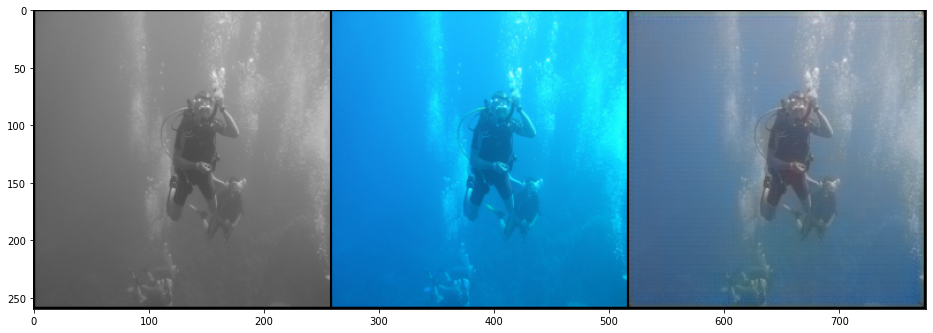

In [40]:
x,y = val_dataset[70]
model = model.to(device)
model.eval()
with torch.no_grad():
    yhat =  model(x.unsqueeze(0).to(device)).squeeze(0).cpu().detach()
x = denormalize(x, mean, std)
mymshow(torchvision.utils.make_grid(torch.stack([x,y,yhat],dim=0),nrow=3),fig_size=(16,16)) 

In [ ]:
# 19 239 5